In [1]:
import pandas as pd
fp = "/Users/melika/Documents/MScProject/FireData/correct_encoded.csv"
df = pd.read_csv(fp, dtype=str)
df['duration_days'] = df['duration_days'].astype(int)
df = df.drop('Unnamed: 0',axis = 1)

In [2]:
defaults = {
'cause_H':'1',
'cause_PB':'0',
'cause_L':'0',
'cause_RE':'0',
'cause_U':'0', 
'1':'0', 
'2':'0',
'3':'0',
'4':'0',
'Crown':'0',
'Dump':'0',
'Forest':'0',
'Grass':'0',
'Ground':'0',
'IFR':'0',
'OFR':'0',
'Other':'0', 
'Prescribed Burn':'0',
'Req For Assist':'0', 
'Request For Ass*':'0',
'Surface':'0',
'Wildfire':'0',
'Summer':'1',
'Fall':'0', 
'Winter':'0', 
'Spring':'0',
'Size>-4':'1', 'Size>-2':'1', 'Size>-1':'1', 'Size>0':'1',
'Size>1':'0', 'Size>2':'0', 'Size>3':'0', 'Size>4':'0', 'Size>5':'0', 'Size>6':'0', 
'after1940':'1', 'after1950':'1', 'after1960':'1', 'after1970':'1', 'after1980':'1', 'after1990':'1',
       'after2000':'0', 'after2010':'0', 'after2020':'0'
}

In [3]:
#df.loc[df['duration_days'] < 0 , 'duration_days'] = -10 #Error
df = df[~(df['duration_days'] < 0)] #remove error
df.loc[df['duration_days'] > 10, 'duration_days'] = -1 #large
df.loc[df['duration_days'] >= 0, 'duration_days'] = 0
df.loc[df['duration_days'] == -1, 'duration_days'] = 1
#df.loc[df['duration_days'] > 5, 'duration_days'] = -2 #Med
#df.loc[df['duration_days'] > 2, 'duration_days'] = -3 #Med Low
#df.loc[df['duration_days'] == 2, 'duration_days'] = 2 #2
#df.loc[df['duration_days'] == 1, 'duration_days'] = 1 #1
#df.loc[df['duration_days'] == 0, 'duration_days'] = 0 #0

In [38]:
X = df.loc[df['duration_days'] == -1, 'duration_days'] = 1
gp1 = df.loc[df['ECOZONE'] == '9']
gp2 = df.loc[df['ECOZONE'] == '10']
print(gp1.shape , gp2.shape)
label_col = 'duration_days'
all_label_values = list(set(list(df[label_col].values)))
print(all_label_values)


(54237, 47) (1063, 47)
[0, 1]


In [39]:
from collections import defaultdict
counter_dict = defaultdict(lambda: 0) #h ^ v, the keys would be (h, column_name, value of column)
not_counter_dict =  defaultdict(lambda: 0)
columns = list(gp1.columns)
columns.remove(label_col)
columns.remove('ECOZONE')
for index, row in gp1.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        counter_dict[key] += 1
        for val in all_label_values:
            if val != h:
                not_counter_dict[(val, c, row[c])] += 1

In [40]:
from collections import defaultdict
counter_dict2 = defaultdict(lambda: 0) #h ^ v, the keys would be (h, column_name, value of column)
not_counter_dict2 =  defaultdict(lambda: 0)
columns = list(gp2.columns)
columns.remove(label_col)
columns.remove('ECOZONE')

for index, row in gp2.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        counter_dict2[key] += 1
        for val in all_label_values:
            if val != h:
                not_counter_dict2[(val, c, row[c])] += 1
        

In [41]:
c0 = 0
c1 = 0
p = defaultdict(lambda: 0) # a dictionary for p(h | v_i), the keys would be (h, column_name, value of column)
p2 = defaultdict(lambda: 0) # a dictionary for p(h | v_i), the keys would be (h, column_name, value of column)
    
for index, row in gp1.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        p[key] = (counter_dict[key] + c0) / (counter_dict[key] + not_counter_dict[key] + c1)
        

In [42]:
for index, row in gp2.iterrows():
    h = row[label_col]
    for c in columns:
        key = (h, c, row[c])
        p2[key] = (counter_dict2[key] + c0) / (counter_dict2[key] + not_counter_dict2[key] + c1)
        

shape (15820, 47)


In [44]:
print(len(labels), len(direct_prob), len(ods_mult_prob))

711892 711892 711892


len 711892
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mul

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mul

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
m

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
m

mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mu

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
m

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult

mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mu

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mu

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.0092

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mul

mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00922882427

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mu

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
m

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
m

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult,

mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.007

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.0092

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962

mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009

mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.0091661925532587

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.00922882427307206

mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349


mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795


mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072

mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.00922882427307

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
m

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.008827523766410

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0081945190757657

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult

mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869


mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
m

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.0069555540098768

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mu

mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mu

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mu

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.0087

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
140000
0.9762257496279676 0.013376197680476739 0.013376197680476739
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009

mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.00525

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
m

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mul

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
m

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mul

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.0091661925532587

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.00

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult,

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mu

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mu

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.0092288242730720

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mu

mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
m

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mu

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.006251941924710

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mu

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult

mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult,

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mul

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
m

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.0092

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult,

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mu

mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult,

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.0092288242730720

mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.0092288242730720

mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mul

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mu

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
m

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
m

mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult,

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mu

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.037

mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.00922882427307206

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092288242730720

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mu

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
m

mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mu

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mul

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mu

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult,

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
m

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741


mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mu

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
m

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887


mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mu

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
m

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.00

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
310000
0.9762257496279676 0.013376197680476739 0.013376197680476739
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092288

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.0069555540098768

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.01014

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.00874974365985371

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mul

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mu

mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mu

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mul

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
m

mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mu

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009

math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.00

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.00

mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mu

mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult,

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
ma

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.0102112

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
m

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mu

mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mul

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
m

mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mu

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.0101

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009

mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008

mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mu

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mu

mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00

mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mu

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.0087

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult,

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
m

mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mul

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
m

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.0052

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mul

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult,

mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.00

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.00

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
m

mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.00525

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mu

mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mu

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.0069

mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.00

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.015

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.00525974025974

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009

mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mu

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mul

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mul

mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.00922

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.0092

mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
m

mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.0092

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mul

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mu

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mul

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult

mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mul

mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mul

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mul

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023

mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.0101

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mu

mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.00

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.0234

mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.00

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mu

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00922882427

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
ma

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.01

mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.0102

mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.00

mult, 0.006955554009876887
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092288242

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult,

mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult,

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
math domain error
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.01021

mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
math domain error
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00

mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
m

mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593

mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062


mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
m

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
m

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.0092288242730720

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mul

mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
m

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.0092288242730720

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072

mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.0091661925532587

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.001382548488376186

mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.004689052491174009
mult, 0.0062519419247100685
mult, 0.010449574726609965
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.00138254848837618

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062


mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.00922882427307

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072

mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092288242730720

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.00912268735612

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mul

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.00874974365985

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072

mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
m

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.00922882427307

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
m

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mul

mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072

mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747


mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00922882427307

mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mul

mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092288242730720

mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00918609879874

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.01044957472660

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716

mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mu

mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.00922882427307206

mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.00879023588186934

mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.00525974025974025

mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.00923037749061047

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mu

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
m

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
m

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 

mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mul

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.00698978416160995

mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.03717739009247836
mult, 0.009228824273072062
mult, 0.03668492299224242
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult

mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.0069555540098768

mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult

mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mu

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mu

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0088275237664101

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult

mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.00922882427307206

mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.00971135689236579

mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mu

mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
m

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mu

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mu

mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.00698978416160995

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.13792221579369235
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0

mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.0092288242730720

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mul

mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.0097113568923657

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mul

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.0091226873561258

mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mu

mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mul

mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062


mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
m

mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.0010978714189670623
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.0946798644499548
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.0062519419247100685
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mu

mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.0092288242730720

mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mu

mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.005220349127464747
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.010449574726609965
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.0092288242730720

mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.008194519075765716
mult, 0.00882752376641014
mult, 0.023423090798487003
mult, 0.009122687356125841
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.00922882427307206

mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.016167953667953667
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.0013503490458531644
mult, 0.0013514039814541783
mult, 0.0013825484883761869
mult, 0.0015014190442837593
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.0092288242730720

mult, 0.023423090798487003
mult, 0.023100216954700263
mult, 0.009228824273072062
mult, 0.006989784161609954
mult, 0.009228824273072062
mult, 0.006955554009876887
mult, 0.009228824273072062
mult, 0.009672516236009397
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009230377490610476
mult, 0.008749743659853716
mult, 0.009711356892365795
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009186098798740928
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.009228824273072062
mult, 0.011353908610086191
mult, 0.008452016504725143
mult, 0.009228824273072062
mult, 0.01522658610271903
mult, 0.01013618074899412
mult, 0.010144029735171133
mult, 0.010211240159014732
mult, 0.015037593984962407
mult, 0.005259740259740259
mult, 0.0073534072900158474
mult, 0.008790235881869349
mult, 0.009166192553258741
mu

(635426.3851837475, 53345.16345074893, 53311.276837477795)

In [9]:
#Check for specific column
ratio_prob = defaultdict(list)
direct_prob = defaultdict(list)
labels = defaultdict(list)
ods_prob = defaultdict(list)
ods_mult_prob = defaultdict(list)
wished_columns = columns
#wished_columns = ['cause_H', 'cause_RE', 'Size>1', 'Size>4', 'after2000', 'Summer', 'Winter']
counter_p2_0 = 0
counter_p0 = 0
counter_ratio1 = 0
print("shape", gp2.shape)
h = 1
for index, row in gp2.iterrows():

    r = row[label_col]
    
    for c in columns:
        key = (h, c, row[c])
        def_key = (h, c, defaults[c])
        #print(key, def_key)
        if p2[def_key] == 0:
            counter_p2_0 +=1 
            print("p2 is zero", def_key)
        if p[def_key] == 0:
            counter_p0 += 1
            print("Can not calculate ratio, p default is not available", key, def_key)
            continue
        ratio_p = (p[key]/p[def_key]) * p2[def_key]
        if p[key] >= 1 or p2[key] >= 1:
            continue
        odds_1 = p[key] / (1-p[key])
        odds_2 = p2[key] / (1-p2[key])
        if ratio_p > 1:
            counter_ratio1 += 1
            odds_def1 = p[def_key] / (1-p[def_key])
            odds_def2 = p2[def_key] / (1-p2[def_key])
            ods_pred = odds_1 - odds_def1 + odds_def2
            mult_pred = odds_1 * odds_def2 / odds_def1 
            direct_p= p[key]
            ratio_prob[c].append(ratio_p)
            direct_prob[c].append(direct_p)
            labels[c].append(row[label_col])
            ods_mult_prob[c].append(mult_pred/(1+mult_pred))
            print("ratio pred",  ratio_p, "ods pred", ods_pred, "ods mult pred", mult_pred)
            continue
        direct_p= p[key]
        ratio_prob[c].append(ratio_p)
        direct_prob[c].append(direct_p)
        labels[c].append(row[label_col])
        odds_def1 = p[def_key] / (1-p[def_key])
        odds_def2 = p2[def_key] / (1-p2[def_key])
        ods_pred = odds_1 - odds_def1 + odds_def2
        mult_pred = odds_1 * odds_def2 / odds_def1 
        ods_prob[c].append(ods_pred / (1 + ods_pred))
        ods_mult_prob[c].append(mult_pred/(1+mult_pred))

shape (1063, 47)
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.4895828923304617 ods pred 6.864899957811992 ods mult pred 12.421394141604262
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.

ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.4895828923304617 ods pred 6.864899957811992 ods mult pred 12.421394141604262
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256
ratio pred 1.2514702851812203 ods pred 1.9832354559100875 ods mult pred 3.9138551628991256


In [50]:
print(cnt)

711892


In [10]:
number_of_samples = 0
ratio_bad = 0
ratio_prob = defaultdict(list)
direct_prob = defaultdict(list)
labels = defaultdict(list)
ods_prob = defaultdict(list)
ods_mult_prob = defaultdict(list)
print("h", h)
ratio_prob1 = []
direct_prob1 = []
labels1 = []
ods_mult_prob1 = []
cnt = 0
for index, row in gp2.iterrows():

    r = row[label_col]
    for c in columns:
        if c not in wished_columns: 
            continue
        key = (h, c, row[c])
        def_key = (h, c, defaults[c])
        # print(key, def_key)
        if p2[def_key] == 0:
            counter_p2_0 += 1
            print("p2 is zero", def_key)
        if p[def_key] == 0:
            counter_p0 += 1
            #print("Can not calculate ratio, p default is not available", key, def_key)
            continue
        ratio_p = (p[key] / p[def_key]) * p2[def_key]
        if p[key] >= 1 or p2[key] >= 1:
            print("P is greater than 1!!!!!", p[key], key)
            continue
        odds_1 = p[key] / (1 - p[key])
        odds_2 = p2[key] / (1 - p2[key])
        if ratio_p > 1:
            ratio_bad += 1
            ratio_p = 1
            print("ratio prob greater than 1", key, def_key, ratio_p, p[key], p[def_key], p2[def_key])
        direct_p = p[key]
        cnt += 1
        ratio_prob[c].append(ratio_p)
        direct_prob[c].append(direct_p)
        labels[c].append(row[label_col])
        odds_def1 = p[def_key] / (1 - p[def_key])
        odds_def2 = p2[def_key] / (1 - p2[def_key])
        mult_pred = odds_1 * odds_def2 / odds_def1
        ods_mult_prob[c].append(mult_pred / (1 + mult_pred))
        ods_mult_prob1.append(mult_pred / (1 + mult_pred))
        ratio_prob1.append(ratio_p)
        direct_prob1.append(direct_p)
        labels1.append(row[label_col])



h 1
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>3', '1') (1, 'Size>3', '0') 1 0.8715890850722311 0.08529488566419219 0.1457725947521866
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
rati

ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>3', '1') (1, 'Size>3', '0') 1 0.8715890850722311 0.08529488566419219 0.1457725947521866
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>3', '1') (1, 'Size>3', '0') 1 0.8715890850722311 0.08529488566419219 0.1457725947521866
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio prob greater than 1 (1, 'Size>2', '1') (1, 'Size>2', '0') 1 0.6548720740337507 0.07467557251908397 0.1427061310782241
ratio pr

In [48]:
for c in columns:
    print(len(labels[c]), len(direct_prob[c]) , len(ods_mult_prob[c]))

15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15813 15813 15813
15819 15819 15819
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820
15820 15820 15820


In [11]:
from math import log2
tdirect_loss = []
tratio_loss = []
todd_loss = []
tmult_loss = []
print("9 to 10")
wished_columns = columns
counter = 0


tot_dir = 0
tot_mult = 0
for c in wished_columns:
    direct_loss = 0
    ratio_loss = 0
    odd_loss = 0
    error_cnt = 0 
    mult_loss = 0
    for i in range(len(labels[c])):
        counter += 1

        try:
            direct = direct_prob[c][i]
            rat = ratio_prob[c][i]
            #od = ods_prob[c][i]
            mult = ods_mult_prob[c][i]
            #print(direct, rat, labels[i])

            #if labels[i] == 1:
            #   rat = 1-rat
            #  direct = 1-direct
            y = labels[c][i]
            l1 = -(y * log2(direct) + (1-y)*log2(1-direct))
            l2 = -(y * log2(rat) + (1-y)*log2(1-rat))
            #l3 = -(y * log2(od) + (1-y)*log2(1-od))
            #print("mult,", mult)
            l4 = -(y * log2(mult) + (1-y)*log2(1-mult))
            direct_loss += l1
            tot_dir += l1
            ratio_loss += l2
            #odd_loss += l3
            mult_loss += l4
            tot_mult += l4
        except Exception as E:
            print(E)
            error_cnt += 1
            continue
    size = len(labels[c])
    print( c, direct_loss/size, ratio_loss/size, mult_loss/size )
    x1 = float(direct_loss)/size
    x2 = float(mult_loss)/size
    if x1 < 0.2:
        print("hellooo" , c, x1, mult_loss/size)
    tdirect_loss.append(x1)
    tratio_loss.append(ratio_loss/size)
    todd_loss.append(odd_loss/size)
    tmult_loss.append(x2)

9 to 10
cause_H 0.6312520640646223 0.614198448425477 0.6141434064232725
cause_PB 0.6294259072017458 0.6074744113483529 0.6074744113483529
cause_L 0.6305091509209625 0.6124044722583089 0.6124500448602612
cause_RE 0.6371878659648177 0.6134772968153855 0.6134772968153855
cause_U 0.6285874585014504 0.6074744113483529 0.6074744113483529
1 0.6371834835040151 0.6134772968153855 0.6134772968153855
2 0.6371834835040151 0.6134772968153855 0.6134772968153855
3 0.6371834835040151 0.6134772968153855 0.6134772968153855
4 0.6371834835040151 0.6134772968153855 0.6134772968153855
Crown 0.6400289212335358 0.6137684730614891 0.6137379669420918
Dump 0.6371834835040151 0.6134772968153855 0.6134772968153855
Forest 0.6371834835040151 0.6134772968153855 0.6134772968153855
Grass 0.6371834835040151 0.6134772968153855 0.6134772968153855
Ground 0.6358199053647398 0.6131972944053499 0.6132146642141287
IFR 0.6371834835040151 0.6134772968153855 0.6134772968153855
OFR 0.6371834835040151 0.6134772968153855 0.613477296

In [43]:
# print(p[(1, 'Size>1', '1')])
# print(p[(1, 'Size>1', '0')])
# print(p2[(1, 'Size>1', '1')])
# print(p2[(1, 'Size>1', '0')])
def_key = (0,'Size>1', '0')
# print("=========")
# print(counter_dict[(1, 'Size>1', '1')])
# print(counter_dict[(1, 'Size>1', '0')])
print(counter_dict2[(1, 'Size>1', '1')])
print(counter_dict2[(1, 'Size>1', '0')])
# print("======second pop:=======")
# print(counter_dict[(0, 'Size>1', '1')])
# print(counter_dict[(0, 'Size>1', '0')])
print(counter_dict2[(0, 'Size>1', '1')])
print(counter_dict2[(0, 'Size>1', '0')])

key_1 = (0, 'Size>1', '1')
           
x = p[key_1] * p2[def_key] / p[def_key] 
y = p2[key_1]
print(p[key_1], p2[key_1])
print(x, y)
print(p2[key])

62
99
220
682
0.6049192928516526 0.7801418439716312
0.563399422305283 0.7801418439716312
0.8485418626528692


In [25]:
from math import log2
tdirect_loss = []
tratio_loss = []
todd_loss = []
tmult_loss = []

print("12 to 8")
for c in wished_columns:
    direct_loss = 0
    ratio_loss = 0
    odd_loss = 0
    counter = 0
    error_cnt = 0 
    mult_loss = 0
    for i in range(len(labels[c])):
        counter += 1

        try:
            direct = direct_prob[c][i]
            rat = ratio_prob[c][i]
            od = ods_prob[c][i]
            mult = ods_mult_prob[c][i]
            #print(direct, rat, labels[i])

            #if labels[i] == 1:
            #   rat = 1-rat
            #  direct = 1-direct
            y = labels[c][i]
            l1 = -(y * log2(direct) + (1-y)*log2(1-direct))
            l2 = -(y * log2(rat) + (1-y)*log2(1-rat))
            l3 = -(y * log2(od) + (1-y)*log2(1-od))
            #print("mult,", mult)
            l4 = -(y * log2(mult) + (1-y)*log2(1-mult))
            if counter % 10000 == 0:
                print(counter)
                print(l1 , l2, l3)
            direct_loss += l1
            ratio_loss += l2
            odd_loss += l3
            mult_loss += l4
        except Exception as E:
            #print(E)
            error_cnt += 1
            continue
    size = len(labels[c])
    print( c, direct_loss/size, ratio_loss/size, odd_loss/size, mult_loss/size )
    x1 = float(direct_loss)/size
    x2 = float(mult_loss)/size
    print("Hello" , x1, x2)
    tdirect_loss.append(x1)
    tratio_loss.append(ratio_loss/size)
    todd_loss.append(odd_loss/size)
    tmult_loss.append(x2)

12 to 8
cause_H 0.0 0.0 0.0 0.0
Hello 0.0 0.0
cause_PB 0.0 0.0 0.0 0.0
Hello 0.0 0.0
cause_L 0.0 0.0 0.0 0.0
Hello 0.0 0.0
cause_RE 0.0 0.0 0.0 0.0
Hello 0.0 0.0
cause_U 0.0 0.0 0.0 0.0
Hello 0.0 0.0
1 0.0 0.0 0.0 0.0
Hello 0.0 0.0
2 0.0 0.0 0.0 0.0
Hello 0.0 0.0
3 0.0 0.0 0.0 0.0
Hello 0.0 0.0
4 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Crown 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Dump 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Forest 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Grass 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Ground 0.0 0.0 0.0 0.0
Hello 0.0 0.0
IFR 0.0 0.0 0.0 0.0
Hello 0.0 0.0
OFR 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Other 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Prescribed Burn 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Req For Assist 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Request For Ass* 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Surface 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Wildfire 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Summer 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Fall 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Winter 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Spring 0.0 0.0 0.0 0.0
Hello 0.0 0.0
Size>-4 0.0 0.0 0.0 0.0
He

[0.22645648274040983, 0.26040429727948566, 0.22881739670585582, 0.26024802331802976, 0.26142076865115993, 0.2612637554646512, 0.2612548835150685, 0.2612293503288696, 0.261232996847555, 0.2582257464280463, 0.2612293503288696, 0.2612293503288696, 0.2612293503288696, 0.27005943297790536, 0.25721640553549957, 0.26123026192481336, 0.2612293503288696, 0.2609913766373594, 0.2612236263824511, 0.2612293503288696, 0.25903307646776935, 0.24861269759617197, 0.26310561182273834, 0.261195188274136, 0.2669993772228307, 0.2565326868902331, 0.2736910052215578, 0.2736910052215578, 0.20011593542714262, 0.20248675930646468, 0.19267690275299892, 0.2098152528350074, 0.23357189714540216, 0.25400699641457797, 0.2608997199510976, 0.2612293503288696, 0.2612293503288696, 0.2612293503288696, 0.2612293503288696, 0.2612293503288696, 0.2688469062027458, 0.28847293867889956, 0.3138409961429485, 0.29510990138805593, 0.2612293503288696]


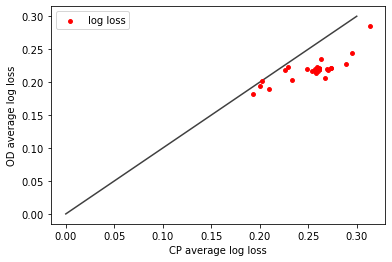

<Figure size 432x288 with 0 Axes>

In [31]:
import matplotlib.pyplot as plt

fig = plt.figure()
ax1 = fig.add_subplot(111)
x = [p/10 for p in range(4)]
print(tdirect_loss)

ax1.scatter(tdirect_loss, tmult_loss, s=15, c='r', label='log loss')
ax1.plot(x, x, 'k-', alpha=0.75, zorder=0)
plt.xlabel("CP average log loss")
plt.ylabel("OD average log loss")
plt.legend(loc='upper left');
plt.show()
plt.savefig("6-14.png")

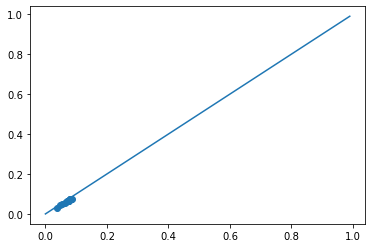

In [61]:
import matplotlib.pyplot as plt
x = [p/100 for p in range(100)]
plt.clf()
matplotlib.pyplot.scatter(tdirect_loss, tratio_loss)
from matplotlib import pyplot as plt
plt.plot(x, x)

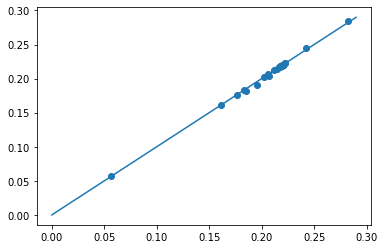

In [17]:
import matplotlib.pyplot
x = [p/100 for p in range(30)]
plt.clf()
matplotlib.pyplot.scatter(tratio_loss, tmult_loss)
from matplotlib import pyplot as plt
plt.plot(x, x)

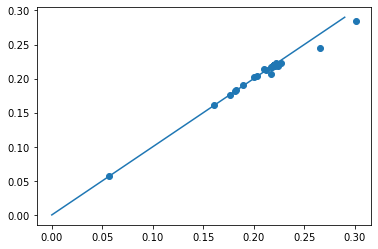

In [31]:
import matplotlib.pyplot
x = [p/100 for p in range(30)]
plt.clf()
matplotlib.pyplot.scatter(todd_loss, tmult_loss)
from matplotlib import pyplot as plt
plt.plot(x, x)

In [36]:
#Check for specific column -> Zone 9
ratio_prob = defaultdict(list)
direct_prob = defaultdict(list)
labels = defaultdict(list)
ods_prob = defaultdict(list)
ods_mult_prob = defaultdict(list)
wished_columns = columns
#wished_columns = ['cause_H', 'cause_RE', 'Size>1', 'Size>4', 'after2000', 'Summer', 'Winter']
counter_p2_0 = 0
counter_p0 = 0
counter_ratio1 = 0
print("shape", gp2.shape)
for index, row in gp2.iterrows():

    r = row[label_col]
    
    for c in columns:
        if c not in wished_columns: 
            continue
        key = (h, c, row[c])
        def_key = (h, c, defaults[c])
        #print(key, def_key)
        if p2[def_key] == 0:
            counter_p2_0 +=1 
            print("p2 is zero", def_key)
        if p[def_key] == 0:
            counter_p0 += 1
            print("Can not calculate ratio, p default is not available", key, def_key)
            continue
        ratio_p = (p[key]/p[def_key]) * p2[def_key]
        if p[key] >= 1 or p2[key] >= 1:
            continue
        odds_1 = p[key] / (1-p[key])
        odds_2 = p2[key] / (1-p2[key])
        if ratio_p > 1:
            counter_ratio1 += 1
            odds_def1 = p[def_key] / (1-p[def_key])
            odds_def2 = p2[def_key] / (1-p2[def_key])
            ods_pred = odds_1 - odds_def1 + odds_def2
            mult_pred = odds_1 * odds_def2 / odds_def1 
            #print("ratio pred",  ratio_p, "ods pred", ods_pred, "ods mult pred", mult_pred)
            continue
        direct_p= p[key]
        ratio_prob[c].append(ratio_p)
        direct_prob[c].append(direct_p)
        labels[c].append(row[label_col])
        odds_def1 = p[def_key] / (1-p[def_key])
        odds_def2 = p2[def_key] / (1-p2[def_key])
        ods_pred = odds_1 - odds_def1 + odds_def2
        mult_pred = odds_1 * odds_def2 / odds_def1 
        ods_prob[c].append(ods_pred / (1 + ods_pred))
        ods_mult_prob[c].append(mult_pred/(1+mult_pred))

shape (54237, 47)


In [46]:
from math import log2
tdirect_loss = []
tratio_loss = []
todd_loss = []
tmult_loss = []


for c in wished_columns:
#    if c == 'cause_H' or c == 'cause_L':
#        continue
    direct_loss = 0
    ratio_loss = 0
    odd_loss = 0
    counter = 0
    error_cnt = 0 
    mult_loss = 0
    for i in range(len(labels[c])):
        counter += 1

        try:
            direct = direct_prob[c][i]
            rat = ratio_prob[c][i]
            od = ods_prob[c][i]
            mult = ods_mult_prob[c][i]
            #print(direct, rat, labels[i])

            #if labels[i] == 1:
            #   rat = 1-rat
            #  direct = 1-direct
            y = labels[c][i]
            l1 = -(y * log2(direct) + (1-y)*log2(1-direct))
            l2 = -(y * log2(rat) + (1-y)*log2(1-rat))
            l3 = -(y * log2(od) + (1-y)*log2(1-od))
            #print("mult,", mult)
            l4 = -(y * log2(mult) + (1-y)*log2(1-mult))
            #if counter % 10000 == 0:
                #print(counter)
                #print(l1 , l2, l3)
            direct_loss += l1
            ratio_loss += l2
            odd_loss += l3
            mult_loss += l4
        except Exception as E:
            #print(E)
            error_cnt += 1
            continue
    size = len(labels[c])
    print( c, direct_loss/size, ratio_loss/size, odd_loss/size, mult_loss/size )
    tdirect_loss.append(direct_loss/size)
    tratio_loss.append(ratio_loss/size)
    todd_loss.append(odd_loss/size)
    tmult_loss.append(mult_loss/size)

cause_H 0.5071524012619327 0.7034771602339555 0.49356936919704303 0.6066249818839401
cause_PB 0.4512619942005617 0.45112131209680717 0.45118934461237864 0.4511767893024012
cause_L 0.5055920162831129 0.6824332826375229 0.4913763397991189 0.595542942976264
cause_RE 0.4503003421758255 0.45022762657272875 0.45022762657272875 0.45022762657272875
cause_U 0.45043452244498516 0.4503749839001056 0.4503687503711644 0.45037464223940754
1 0.45082361241857416 0.45074938670916487 0.45074938670916487 0.45074938670916487
2 0.4508231846502726 0.45074938670916487 0.45074938670916487 0.45074938670916487
3 0.4508219601759729 0.45074938670916487 0.45074938670916487 0.45074938670916487
4 0.45082213444560165 0.45074938670916487 0.45074938670916487 0.45074938670916487
Crown 0.451782462695622 0.4510719856018967 0.4513849055230976 0.45113308411433134
Dump 0.4508219601759729 0.45074938670916487 0.45074938670916487 0.45074938670916487
Forest 0.4508219601759729 0.45074938670916487 0.45074938670916487 0.45074938670

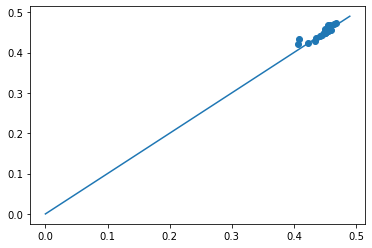

In [45]:
import matplotlib.pyplot
x = [p/100 for p in range(50)]
plt.clf()
matplotlib.pyplot.scatter(tdirect_loss, tratio_loss)
from matplotlib import pyplot as plt
plt.plot(x, x)

In [ ]:
cause_H 0.26413977228134705 0.15894832093490513 0.1659747914053529
cause_PB 0.8918827614553567 0.1577296238656967 0.1577296238656967
cause_L 0.24498098058624948 0.15701389347744243 0.1611006108999736
cause_RE 0.8918827614553567 0.1577296238656967 0.1577296238656967
cause_U 0.8766627232234212 0.15479201287579467 0.15479201287579467
1 0.8918827614553567 0.1577296238656967 0.1577296238656967
2 0.8918827614553567 0.1577296238656967 0.1577296238656967
3 0.8918827614553567 0.1577296238656967 0.1577296238656967
4 0.8918827614553567 0.1577296238656967 0.1577296238656967
Crown 0.8918827614553567 0.1577296238656967 0.1577296238656967
Dump 0.8918827614553567 0.1577296238656967 0.1577296238656967
Forest 0.8918827614553567 0.1577296238656967 0.1577296238656967
Grass 0.8918827614553567 0.1577296238656967 0.1577296238656967
Ground 0.8918827614553567 0.1577296238656967 0.1577296238656967
IFR 0.8916889602981986 0.1577222981055448 0.1577222981055448
OFR 0.8916889602981986 0.1577222981055448 0.1577222981055448
Other 0.8918827614553567 0.1577296238656967 0.1577296238656967
Prescribed Burn 0.8918827614553567 0.1577296238656967 0.1577296238656967
Req For Assist 0.8918827614553567 0.1577296238656967 0.1577296238656967
Request For Ass* 0.8918827614553567 0.1577296238656967 0.1577296238656967
Surface 0.8918827614553567 0.1577296238656967 0.1577296238656967
Wildfire 0.8918827614553567 0.1577296238656967 0.1577296238656967
Summer 0.8795351980916486 0.17178171756197097 0.17024710594000517
Fall 0.8698445273644156 0.15765467285398974 0.15780314873709528
Winter 0.8918827614553567 0.1577296238656967 0.1577296238656967
Spring 0.7990356875981339 0.1603803964998448 0.15755599468302955
Size>-4 0.7007766945558129 0.13695320578812142 0.13695320578812142
Size>-2 0.7007766945558129 0.13695320578812142 0.13695320578812142
Size>-1 0.9539304750475657 0.15759579733500498 0.15950043654028628
Size>0 1.069165356899135 0.1552843633073197 0.15813621633927483
Size>1 0.5116799522995856 0.1497573698237292 0.1475474716294735
Size>2 0.5845459556590077 0.1565335020863195 0.15504862468837524
Size>3 0.7055496074942268 0.1577296238656967 0.1577296238656967
Size>4 0.833025090622352 0.1577296238656967 0.1577296238656967
Size>5 0.8918827614553567 0.1577296238656967 0.1577296238656967
Size>6 0.8918827614553567 0.1577296238656967 0.1577296238656967
after1940 0.8918827614553567 0.1577296238656967 0.1577296238656967
after1950 0.8918827614553567 0.1577296238656967 0.1577296238656967
after1960 0.8918827614553567 0.1577296238656967 0.1577296238656967
after1970 0.8918827614553567 0.1577296238656967 0.1577296238656967
after1980 0.7598761786772142 0.1254695608226703 0.1254695608226703
after1990 0.8891428637237514 0.11845289835915976 0.11845289835915976
after2000 1.9355464678216432 0.15657128122607758 0.15763429092260575
after2010 0.9705710844221309 0.15756468575806923 0.1574519824173857
after2020 0.8918827614553567 0.1577296238656967 0.1577296238656967